<a href="https://colab.research.google.com/github/shun601/4th-tellus-satellite-challenge/blob/main/preprocess.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### 原初データ提供者：国立研究開発法人宇宙航空研究開発機構    
#### Original data provided by JAXA


# 1 はじめに
本ファイルは、[「The 4th Tellus Satellite Challenge：海岸線の抽出」](https://signate.jp/competitions/284)コンペにてデータの前処理を行ったコードです。  


# 2 前処理のコード詳細
以下に実装したコードを示します。

## 2.1 モジュールのインポート

In [ ]:
# コードスタイルのチェックに使う
!pip install pycodestyle flake8 pycodestyle_magic
%load_ext pycodestyle_magic

     |████████████████████████████████| 51kB 3.6MB/s 
     |████████████████████████████████| 81kB 4.6MB/s 
     |████████████████████████████████| 71kB 4.8MB/s 


In [ ]:
import cv2
import glob
import json
import os
from PIL import Image
import random
import tifffile

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
%matplotlib inline


sns.set(style='ticks')

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
# 作業ディレクトリ変更
os.chdir("/gdrive/My Drive/Colab Notebooks/signate/Tellus4/code/")
print(os.getcwd())

/gdrive/My Drive/Colab Notebooks/signate/Tellus4/code


## 2.2 グローバル変数の定義
与えられたtrainデータ、testデータ、trainアノテーションデータのパスをグローバル変数で定義する。

In [ ]:
# 与えられたtrainデータのパス
TRAIN_IMAGES_PATH = sorted(glob.glob('../data/train_images/*'))

# 与えられたtestデータのパス
TEST_IMAGES_PATH = sorted(glob.glob('../data/test_images/*'))

# 与えられたtrainデータのアノテーションのパス
TRAIN_ANNOTATIONS_PATH = sorted(glob.glob('../data/train_annotations/*'))

## 2.3 関数作成

In [ ]:
class LoadIndexError(Exception):
    """ 独自例外を発生させるクラス """


def load_path_train_and_anno(idx):
    """
    trainデータ、アノテーションデータからファイルパスとファイル名を取得する関数

    parameters:
    -----------------------------------
    idx -> int
        trainデータの番号

    Returns:
    -----------------------------------
    train_tif_path: -> trainデータのファイルパス
    train_tif_name: -> trainデータのファイル名
    anno_path: -> アノテーションデータのパス
    """
    global TRAIN_IMAGES_PATH
    global TRAIN_ANNOTATIONS_PATH

    if idx > len(TRAIN_IMAGES_PATH) - 1:
        raise LoadIndexError('データが存在しません。引数idxを確認してください')

    train_tif_path = TRAIN_IMAGES_PATH[idx]
    train_tif_name = os.path.split(train_tif_path)[-1]
    anno_path = TRAIN_ANNOTATIONS_PATH[idx]

    return train_tif_path, train_tif_name, anno_path


def load_path_test(idx):
    """
    testデータのファイルパスとファイル名を取得する関数

    parameters:
    -----------------------------------
    idx -> int
        trainデータの番号

    Returns:
    -----------------------------------
    test_tif_path: -> testデータのファイルパス
    test_tif_name: -> testデータのファイル名
    """
    global TEST_IMAGES_PATH

    if idx > len(TEST_IMAGES_PATH) - 1:
        raise LoadIndexError('データが存在しません。引数idxを確認してください')

    test_tif_path = TEST_IMAGES_PATH[idx]
    test_tif_name = os.path.split(test_tif_path)[-1]

    return test_tif_path, test_tif_name

In [ ]:
def save_annotation_image(idx):
    """
    与えられたtrainデータとアノテーションデータを重ね合わせて、新たな画像として保存する関数。
    保存された画像は、セグメンテーション用マスク作成に使用する（手動で色を塗り分ける）

    parameters:
    -----------------------------------
    idx -> int
        trainデータの番号

    Returns:
    -----------------------------------
    None
    """
    # trainデータのファイルパス、ファイル名、アノテーションデータを取得
    train_tif_path, _, anno_path = load_path_train_and_anno(idx=idx)

    # trainデータとアノテーションデータを読み込み
    data = tifffile.imread(train_tif_path)
    with open(anno_path, "r") as fp:
        annotation = json.load(fp)

    # 対数をとる
    data_log = np.log1p(data)
    # 欠損値
    data_log_nan = np.where(data_log == 0, np.nan, data_log)
    # 欠損していないデータ
    data_log_non_nan = data_log_nan[~np.isnan(data_log_nan)]

    # パーセンタイル 3%, 97%で正規化　目視しやすいように。
    # c_arrayには3%、97%点が、リストで格納される。
    c_array = np.percentile(data_log_non_nan, q=[3, 97])

    # 正規化(データを0~255に変換する)
    # データから正規化する最小値を引き、正規化するレンジで割る（最小が0, 最大が１になる） -> 255をかけると、0~255になる
    data_log_normalized = (data_log - c_array[0]) / (c_array[1] - c_array[0]) * 255
    # 0以下、255以上をnp.clipでクリップする。
    data_log_normalized = np.clip(data_log_normalized, 0, 255)
    # dtypeをnp.uint8に変換
    data_log_normalized = data_log_normalized.astype(np.uint8)

    # 正規化したデータと同じshapeの零行列を用意
    data_anno = np.zeros_like(data_log_normalized)

    # coastling_pointsをデータフレームに格納
    df = pd.DataFrame(annotation['coastline_points'], columns=["x", "y"])

    # df.iterrows()で1行ずつ座標を取り出し、その座標部分を1、それ以外は0に設定
    for _, row in df.iterrows():
        x = row['x']
        y = row['y']
        data_anno[y, x] = 1

    # RGB作成(axis=2方向に3チャンネル分stackする)
    img_rgb = np.stack([data_log_normalized, data_log_normalized, data_log_normalized], axis=2)

    # アノテーション点の箇所をRed色にする
    img_rgb[:, :, 0] = np.where(data_anno == 1, 255, img_rgb[:, :, 0])

    # アノテーション用画像を保存
    save_dir = '../data/annotation_image'
    filename = '../data/annotation_image/image_anno_{:02d}.png'.format(idx)

    img_rgb = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2RGB)
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    cv2.imwrite(filename, img_rgb)
    print("Saved: {}".format(filename))


In [ ]:
def normalized_and_convert_to_grayscale(idx, phase='train'):
    """
    train, test画像を標準化し、0-255のグレースケールに変換する関数

    Parameters:
    -------------------------------------
    idx -> int
        trainまたはtest画像の番号
    phase -> 'train' or 'test'
        train画像の場合は'train', test画像の場合は'test'を選択する。

    Returns:
    -------------------------------------
    data_log_normalized -> numpy.ndarray
        入力画像のlogスケールをとり標準化、0-255のグレースケールに変換された画像
    """
    # データの読み込み
    if phase == 'train':
        tif_path, tif_name, _ = load_path_train_and_anno(idx=idx)
    elif phase == 'test':
        tif_path, tif_name = load_path_test(idx=idx)

    data = tifffile.imread(tif_path)

    # logスケールで可視化
    data_log = np.log1p(data)

    # 0の部分は欠損値として処理
    data_log_zero_is_nan = np.where(data_log == 0, np.nan, data_log)

    # 偏差(データ - 平均)を計算
    normalized_numerator = (data_log_zero_is_nan
                            - np.mean(data_log_zero_is_nan[~np.isnan(data_log_zero_is_nan)]))

    # 標準偏差を計算
    normalized_denominator = np.std(data_log_zero_is_nan[~np.isnan(data_log_zero_is_nan)])

    # 偏差/標準偏差で標準化(平均=0, 標準偏差=1)
    data_log_normalized = normalized_numerator / normalized_denominator

    # ±3σでclip
    data_log_normalized = np.clip(data_log_normalized, -3, 3)
    # [0 - 255]
    data_log_normalized = (data_log_normalized + 3) * (255/6)
    # 1未満は1に置き換え
    data_log_normalized = np.where(data_log_normalized < 1, 1, data_log_normalized)
    # nanだった箇所を0に置き換え
    data_log_normalized = np.where(np.isnan(data_log_zero_is_nan), 0, data_log_normalized)
    # np.uint8に変換
    data_log_normalized = data_log_normalized.astype(np.uint8)

    return data_log_normalized, tif_name[:-4]


In [ ]:
def show_mask(name, image, mask):
    """
    train画像とマスク画像を表示する関数。

    Parameters:
    -------------------------------------------------------
    name : -> string型
        画像のファイル名。画像のタイトルとして使用される。
    image : -> numpy.ndarray型
        trainデータ
    mask : -> numpy.ndarray型
        maskデータ

    Returns:
    --------------------------------------------------------
        --> None

    """
    # trainデータの表示
    plt.figure(figsize=(10, 14))
    plt.subplot(1, 2, 1)

    # imageが3チャネル（RGB）の場合
    if image.ndim == 3:
        # imageをRGBで表示
        plt.imshow(image)
    # imageが3チャネル（RGB）でない場合
    else:
        # カラーマップはgrayで表示
        plt.imshow(image, cmap="gray")
    plt.title(f"Image: {name}")

    # maskデータの表示
    plt.subplot(1, 2, 2)
    plt.imshow(mask)
    plt.title(f"mask: {name}")

    return None


## 2.4 データの確認

まず、trainデータを確認する。

In [ ]:
# trainデータの確認
print('trainデータ一覧')
print('-------------------')
for train_image_path in TRAIN_IMAGES_PATH:
    print(train_image_path)
print('-------------------')
print(f'trainデータ数： {len(TRAIN_IMAGES_PATH)}')

trainデータ一覧
-------------------
../data/train_images/train_00.tif
../data/train_images/train_01.tif
../data/train_images/train_02.tif
../data/train_images/train_03.tif
../data/train_images/train_04.tif
../data/train_images/train_05.tif
../data/train_images/train_06.tif
../data/train_images/train_07.tif
../data/train_images/train_08.tif
../data/train_images/train_09.tif
../data/train_images/train_10.tif
../data/train_images/train_11.tif
../data/train_images/train_12.tif
../data/train_images/train_13.tif
../data/train_images/train_14.tif
../data/train_images/train_15.tif
../data/train_images/train_16.tif
../data/train_images/train_17.tif
../data/train_images/train_18.tif
../data/train_images/train_19.tif
../data/train_images/train_20.tif
../data/train_images/train_21.tif
../data/train_images/train_22.tif
../data/train_images/train_23.tif
../data/train_images/train_24.tif
-------------------
trainデータ数： 25


- trainデータは合計25枚、ファイル形式はtifであることが分かる。

testデータを確認する

In [ ]:
# testデータの確認
print('testデータ一覧')
print('-------------------')
for test_image_path in TEST_IMAGES_PATH:
    print(test_image_path)
print('-------------------')
print(f'testデータ数： {len(TEST_IMAGES_PATH)}')

testデータ一覧
-------------------
../data/test_images/test_00.tif
../data/test_images/test_01.tif
../data/test_images/test_02.tif
../data/test_images/test_03.tif
../data/test_images/test_04.tif
../data/test_images/test_05.tif
../data/test_images/test_06.tif
../data/test_images/test_07.tif
../data/test_images/test_08.tif
../data/test_images/test_09.tif
../data/test_images/test_10.tif
../data/test_images/test_11.tif
../data/test_images/test_12.tif
../data/test_images/test_13.tif
../data/test_images/test_14.tif
../data/test_images/test_15.tif
../data/test_images/test_16.tif
../data/test_images/test_17.tif
../data/test_images/test_18.tif
../data/test_images/test_19.tif
../data/test_images/test_20.tif
../data/test_images/test_21.tif
../data/test_images/test_22.tif
../data/test_images/test_23.tif
../data/test_images/test_24.tif
../data/test_images/test_25.tif
../data/test_images/test_26.tif
../data/test_images/test_27.tif
../data/test_images/test_28.tif
../data/test_images/test_29.tif
----------

- testデータは合計30枚、ファイル形式はtifであることがわかる。  

trainアノテーションデータを確認する。

In [ ]:
# trainデータのアノテーションデータの確認
print('trainアノテーションデータ一覧')
print('-------------------')
for train_annotation_path in TRAIN_ANNOTATIONS_PATH:
    print(train_annotation_path)
print('-------------------')
print(f'trainアノテーションデータ数： {len(TRAIN_ANNOTATIONS_PATH)}')

trainアノテーションデータ一覧
-------------------
../data/train_annotations/train_00.json
../data/train_annotations/train_01.json
../data/train_annotations/train_02.json
../data/train_annotations/train_03.json
../data/train_annotations/train_04.json
../data/train_annotations/train_05.json
../data/train_annotations/train_06.json
../data/train_annotations/train_07.json
../data/train_annotations/train_08.json
../data/train_annotations/train_09.json
../data/train_annotations/train_10.json
../data/train_annotations/train_11.json
../data/train_annotations/train_12.json
../data/train_annotations/train_13.json
../data/train_annotations/train_14.json
../data/train_annotations/train_15.json
../data/train_annotations/train_16.json
../data/train_annotations/train_17.json
../data/train_annotations/train_18.json
../data/train_annotations/train_19.json
../data/train_annotations/train_20.json
../data/train_annotations/train_21.json
../data/train_annotations/train_22.json
../data/train_annotations/train_23.json
..

- アノテーションデータは、合計30個、データ形式はjsonであることがわかる。

## 2.5 TIFF画像の可視化

まず、train_00.tifを可視化してみる

In [ ]:
# データの読み込み(train_00.tif)

# trainデータのファイルパスとファイル名を取得
train_tif_path, train_tif_name, _ = load_path_train_and_anno(idx=0)

# tifファイル読み込み
data = tifffile.imread(train_tif_path)

In [ ]:
# データの型、サイズを確認
print(f'trainデータ名: {train_tif_name}')
print(f'データ タイプ: {type(data)}')
print(f'データ shape: {data.shape}')

trainデータ名: train_00.tif
データ タイプ: <class 'numpy.ndarray'>
データ shape: (2914, 5925)


matplotlibでtrain_00.tifを可視化する

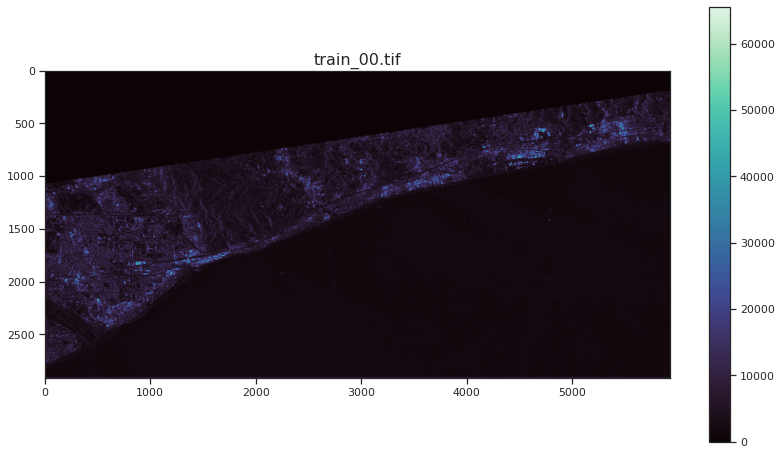

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 8))

ax.set_title(train_tif_name, fontsize=16)
image = ax.imshow(data, cmap='mako')

fig.colorbar(image, ax=ax)

- 画像全体が暗いことが確認できる。

画像の輝度をヒストグラムで確認する

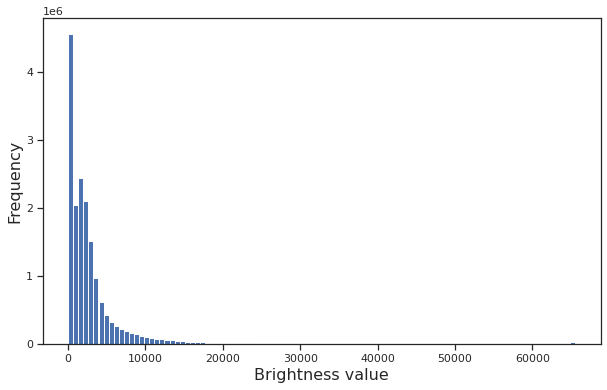

In [ ]:
# 輝度のヒストグラム
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))

ax.hist(data.flatten(), bins=100)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)

plt.show()

読み込んだTIFFファイルの輝度が０付近に偏っていることが分かる。このため画像全体が暗くなっていた。  
そこで、横軸をログスケールでヒストグラムを表示する。

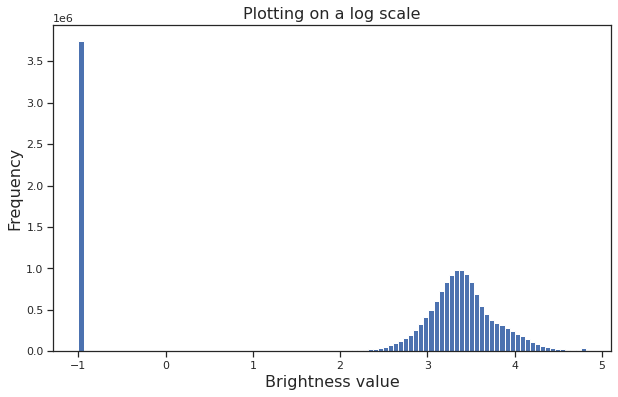

In [ ]:
# 輝度のヒストグラム（log scale）
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))

# 10e-1は-infにならないための工夫。
ax.hist(np.log10(data + 1.0e-1).flatten(), bins=100)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Plotting on a log scale', fontsize=16)

plt.show()

- 輝度値をログスケールにすることによって、画像の暗さを改善できそうであることが確認できる。
- -1に値が集中しているが、logスケールの輝度値-1は$$log_{10}(data+10^{-1})=-1$$つまり、
dataの輝度値が０の場合である。従って、-1は欠損値であることが推定される。    


輝度値のログスケールをとって、train_00.tifの可視化を行ってみる。

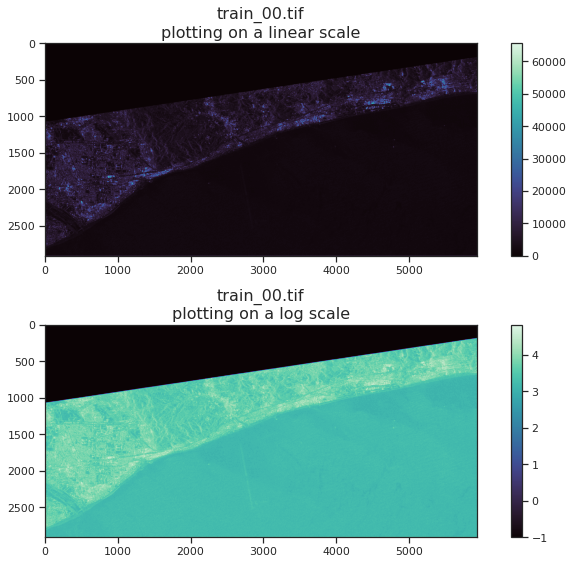

In [ ]:
# linearスケールとlogスケールでTIFFファイルを可視化して比較する
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 8))

# linearスケールで可視化
axes[0].set_title(f"{train_tif_name}\nplotting on a linear scale", fontsize=16)
image = axes[0].imshow(data, cmap='mako')
fig.colorbar(image, ax=axes[0])

# logスケールで可視化
axes[1].set_title(f"{train_tif_name}\nplotting on a log scale", fontsize=16)
image_log = axes[1].imshow(np.log10(data + 1.0e-1), cmap='mako')
fig.colorbar(image_log, ax=axes[1])

fig.tight_layout()

ログスケールをとることで、画像全体を明るく表示することができた。

他のデータでも輝度値を確認してみる。  
train_09.tifの可視化を行う

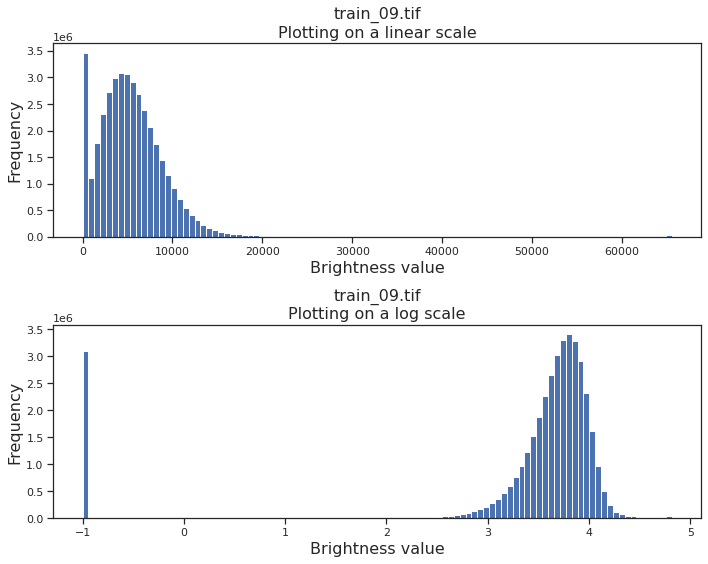

In [ ]:
# 輝度のヒストグラムの可視化(train09.tif)

# trainデータのファイルパスとファイル名を取得(train09.tif)
train_tif_path, train_tif_name, _ = load_path_train_and_anno(idx=9)

# tifファイル読み込み
data = tifffile.imread(train_tif_path)

# linearスケールとlogスケールで輝度値をプロット
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 8))

# 輝度のヒストグラム(linearスケール)
axes[0].hist(data.flatten(), bins=100)
axes[0].set_title(f'{train_tif_name}\nPlotting on a linear scale', fontsize=16)
axes[0].set_xlabel('Brightness value', fontsize=16)
axes[0].set_ylabel('Frequency', fontsize=16)

# 輝度のヒストグラム(logスケール)
axes[1].hist(np.log10(data + 1.0e-1).flatten(), bins=100)
axes[1].set_title(f'{train_tif_name}\nPlotting on a log scale', fontsize=16)
axes[1].set_xlabel('Brightness value', fontsize=16)
axes[1].set_ylabel('Frequency', fontsize=16)

fig.tight_layout()
plt.show()

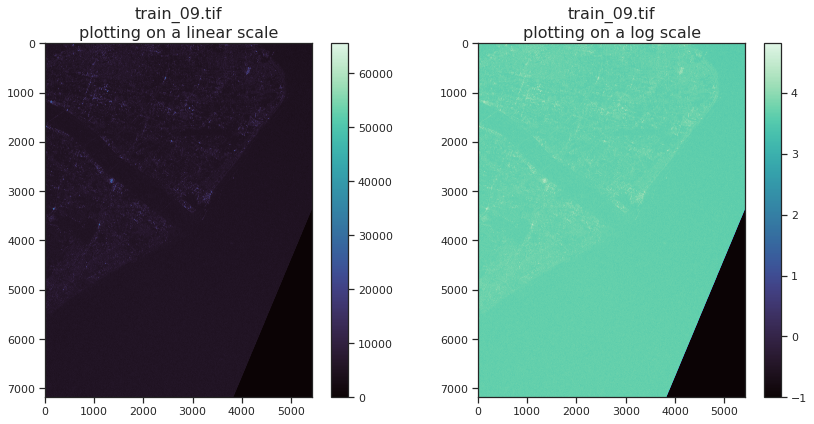

In [ ]:
# linearスケールとlogスケールでTIFFファイルを可視化して比較する
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# linearスケールで可視化
axes[0].set_title(f"{train_tif_name}\nplotting on a linear scale", fontsize=16)
image = axes[0].imshow(data, cmap='mako')
fig.colorbar(image, ax=axes[0])

# logスケールで可視化
axes[1].set_title(f"{train_tif_name}\nplotting on a log scale", fontsize=16)
image_log = axes[1].imshow(np.log10(data + 1.0e-1), cmap='mako')
fig.colorbar(image_log, ax=axes[1])

fig.tight_layout()

#### train画像(TIFF) 全体可視化

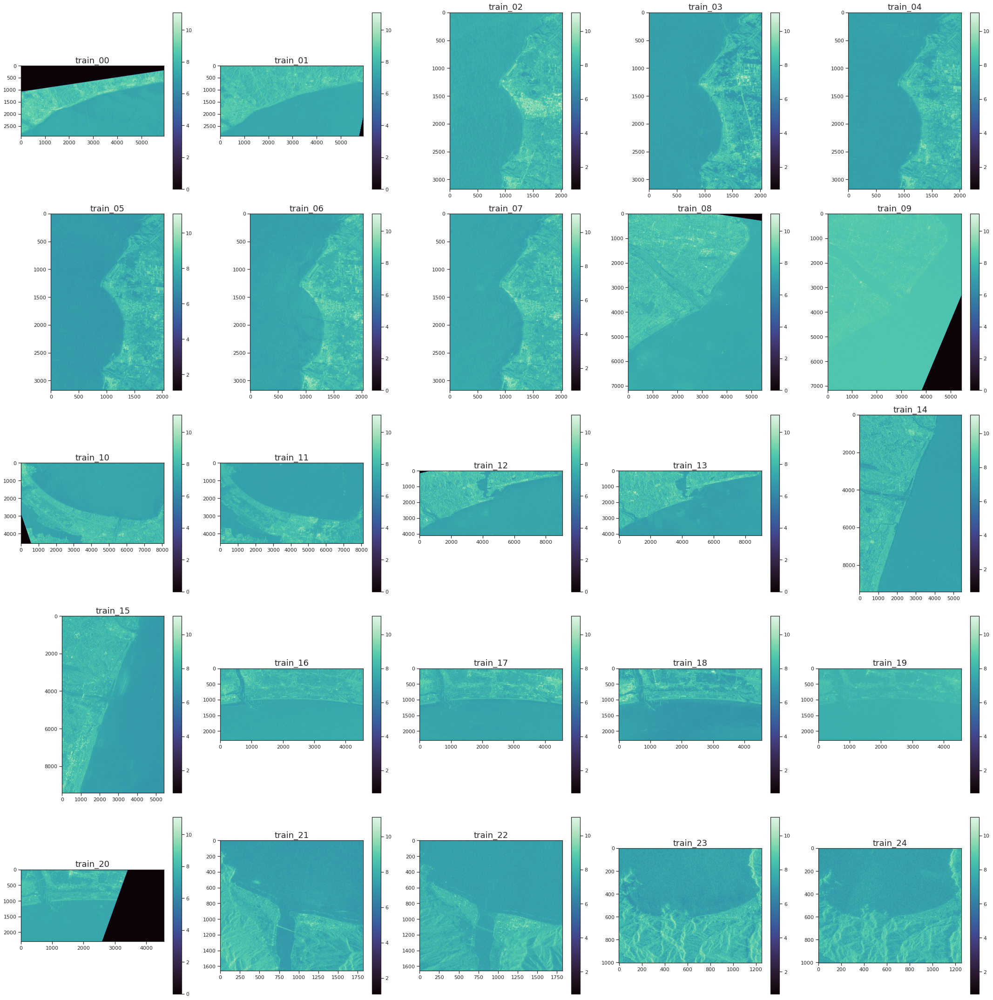

In [ ]:
# 表示させる最大画像枚数(25)
max_count = len(TRAIN_IMAGES_PATH)
# 5列
ncols = 5
# 5行
nrows = max_count // ncols

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6*ncols, 6*nrows))
for idx in range(max_count):
    # train画像(TIFF)全体をlogスケールで可視化
    data = tifffile.imread(TRAIN_IMAGES_PATH[idx])
    row, col = divmod(idx, ncols)
    ax[row][col].set_title(f"train_{idx:02d}", fontsize=18)
    image_log = ax[row][col].imshow(np.log1p(data), cmap='mako')
    fig.colorbar(image_log, ax=ax[row][col])

fig.tight_layout()

## 2.6 アノテーションデータの確認

まず、アノテーションデータのデータ型と、中身を確認する

In [ ]:
# train_09.tifのアノテーション
train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=9)

# アノテーションデータを読み込み
with open(anno_path, "r") as fp:
    annotation = json.load(fp)

# annotationのデータ型確認
print(f'annotationのデータ型: {type(annotation)}')

annotationのデータ型: <class 'dict'>


アノテーションデータのデータ型はdict型であることがわかった。  
dictのkeyを確認する

In [ ]:
print(annotation.keys())

dict_keys(['coastline_points', 'validate_lines'])


アノテーションデータのkeyには、coastline_pointsとvalidate_linesの２つが格納されている。  
coastline_pointsとvalidate_linesのデータ型を確認する。

In [ ]:
# coastline_pointsとvalidate_linesのデータ型を確認する。
for key in annotation.keys():
    print(f'key: {key}\nデータ型: {type(annotation[key])}\n')

key: coastline_points
データ型: <class 'list'>

key: validate_lines
データ型: <class 'list'>



coastline_pointsとvalidate_linesはそれぞれlist型であることがわかった。  
それぞれ、５行出力し、リストの要素を確認する。

In [ ]:
# coastline_pointsの中身を確認する
print('coastline_pointsの要素を、５行だけ表示')
for print_index, value in enumerate(annotation['coastline_points']):
    if print_index == 0:
        print(f'データ型: {type(value)}')
    # 5行だけ表示
    if print_index > 4:
        break
    print(value)

coastline_pointsの要素を、５行だけ表示
データ型: <class 'list'>
[4641, 239]
[4642, 240]
[4643, 241]
[4643, 242]
[4644, 243]


coastline_pointsの要素には、海岸線のxy座標がlist型で格納されている(全てプロットすると、海岸線になる)。


validate_linesの中身を確認する。

In [ ]:
# validate_lineの中身を確認する
print('validate_lineの要素を、５行だけ表示')
for print_index, value in enumerate(annotation['validate_lines']):
    if print_index == 0:
        print(f'データ型: {type(value)}')
    # 5行だけ表示
    if print_index > 4:
        break
    print(value)

validate_lineの要素を、５行だけ表示
データ型: <class 'list'>
[[122.0, 5503.0], [300.0, 5560.0]]
[[131.0, 5485.0], [308.0, 5541.0]]
[[155.0, 5451.0], [309.0, 5543.0]]
[[169.0, 5435.0], [323.0, 5527.0]]
[[192.0, 5412.0], [330.0, 5520.0]]


validate_linesの要素には、海岸線の各座標における評価線の座標(x1,y1), (x2,y2)がlist型で格納されている。

与えられたアノテーションデータについて整理する。
- json形式のtrain_annotationには、各trainデータに対するアノテーション情報が格納されている。
- 読み込んだannotationはdict型で、格納されているkeyとvalueは以下の通り。
    - coastline_points : 海岸線のxy座標がlistで格納されている(全てプロットすると海岸線になる)。
    - validate_lines : 海岸線の各座標における評価線の座標(x1,y1),(x2,y2)がlist型で格納されている。

## 2.7 アノテーションデータのcoastline_pointsを可視化

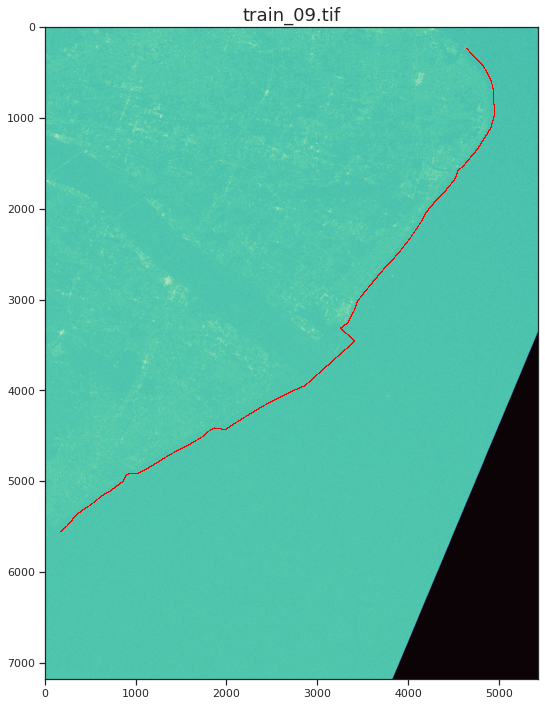

In [ ]:
# trainデータのファイルパス、ファイル名、アノテーションデータを取得(train_09.tif)
train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=9)

# trainデータ読み込み
data = tifffile.imread(train_tif_path)

# アノテーションデータ読み込み
with open(anno_path, "r") as fp:
    annotation = json.load(fp)

# ログスケールでの可視化
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 12))
ax.set_title(f"{train_tif_name}", fontsize=18)
# np.log1p(x) = np.log(1+x)、-inf対策
data_log = np.log1p(data)
ax.imshow(data_log, cmap="mako")

# coastline_pointsを可視化
for point in annotation['coastline_points']:
    # ","はpixel markerを意味する
    ax.plot(point[0], point[1], ",", color="red")

## 2.8 アノテーションデータのvalidate_linesを可視化

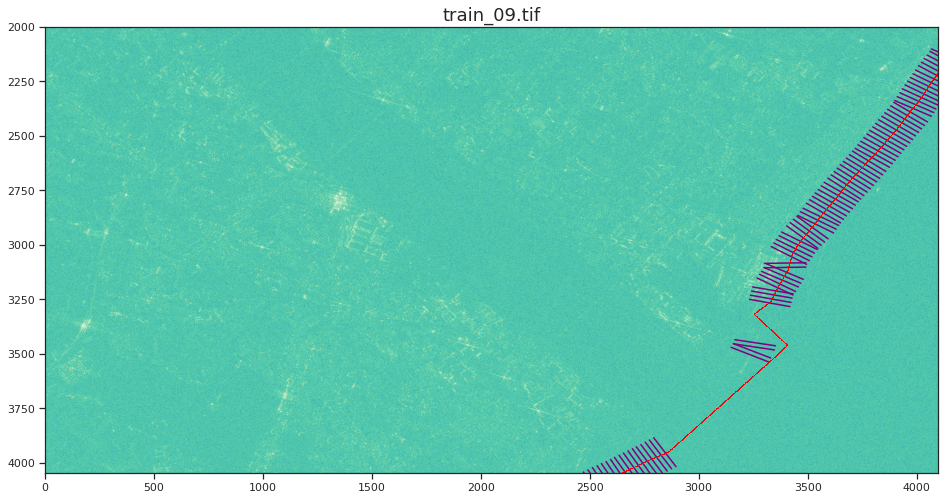

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 12))

# trainデータをmatplotlibで可視化(ログスケール)
ax.set_title(f"{train_tif_name}", fontsize=18)
ax.imshow(np.log1p(data), cmap="mako")

# validate lineをプロット
for line in annotation['validate_lines']:
    ix = [line[i][0] for i in range(2)]
    iy = [line[i][1] for i in range(2)]
    plt.plot(ix, iy, color='purple')

# coastline_pointsをプロット
for point in annotation['coastline_points']:
    plt.plot(point[0], point[1], ",", color="red")

# validate lineが見やすいように、拡大表示
x = 0
y = 2000
ax.set_xlim(x, x+256*8*2)
ax.set_ylim(y, y+256*4*2)
ax.invert_yaxis()

他のデータでも見てみる  
train_14.tifで確認する。

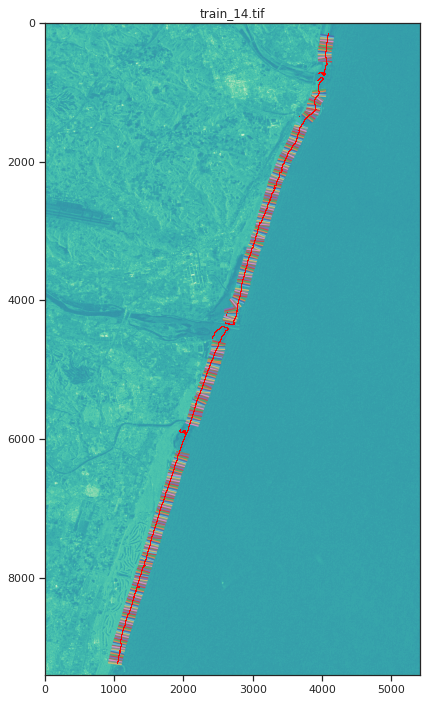

In [ ]:
# trainデータのファイルパス、ファイル名、アノテーションデータを取得(train_14.tif)
train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=14)

# trainデータとアノテーションデータを読み込み
data = tifffile.imread(train_tif_path)
with open(anno_path, "r") as fp:
    annotation = json.load(fp)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 12))
ax.set_title(f"{train_tif_name}")

# train_14.tifをログスケールで可視化
ax.imshow(np.log1p(data), cmap="mako")

# validatte_linesをプロット
for line in annotation['validate_lines']:
    ix = [line[i][0] for i in range(2)]
    iy = [line[i][1] for i in range(2)]
    plt.plot(ix, iy)

# coastline_pointsをプロット
for point in annotation['coastline_points']:
    plt.plot(point[0], point[1], ",", color="red")


#### train画像+アノテーションデータ 全体可視化

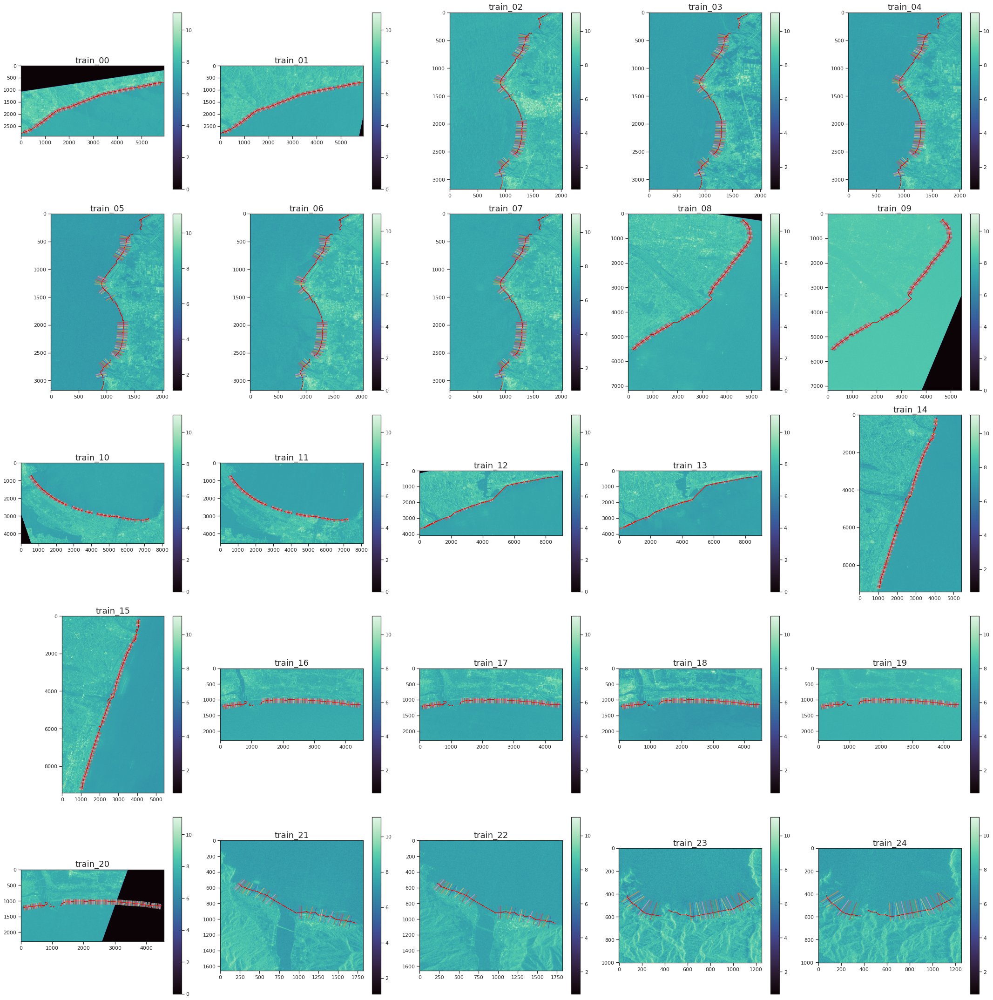

In [ ]:
# 表示させる最大画像枚数(25)
max_count = len(TRAIN_IMAGES_PATH)
# 5列
ncols = 5
# 5行
nrows = max_count // ncols

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6*ncols, 6*nrows))
for idx in range(max_count):
    # trainデータのファイルパス、ファイル名、アノテーションデータを取得
    train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=idx)

    # trainデータとアノテーションデータを読み込み
    data = tifffile.imread(train_tif_path)
    with open(anno_path, "r") as fp:
        annotation = json.load(fp)

    # train画像(TIFF)全体をlogスケールで可視化
    row, col = divmod(idx, ncols)
    ax[row][col].set_title(f"train_{idx:02d}", fontsize=18)
    image_log = ax[row][col].imshow(np.log1p(data), cmap='mako')
    fig.colorbar(image_log, ax=ax[row][col])

    # validatte_linesをプロット
    for line in annotation['validate_lines']:
        ix = [line[i][0] for i in range(2)]
        iy = [line[i][1] for i in range(2)]
        ax[row][col].plot(ix, iy)

    # coastline_pointsをプロット
    for point in annotation['coastline_points']:
        ax[row][col].plot(point[0], point[1], ",", color="red")

fig.tight_layout()

## 2.9 検討

### 2.9.1 セグメンテーション アノテーション検討
- セグメンテーションのアノテーションを検討しましたが、最終的にはペイントやphotoshopを用いて、手動で塗り分けてアノテーションマスク画像を作成した方が良いと判断しました。  
本項のコードはtrain画像とアノテーションを重ね合わせて新しい画像として出力したコードになります。この画像に対し、手動で色を塗り分けることで、セグメンテーションマスクを作成しました。  
下に検討コードを示します。

検討概要：
- アノテーションの点から補間して、上下にわけてみる
    - 欠損が全部埋まるわけではない。画像として保存してペイントで手動でアノテーションした方が良いと判断。

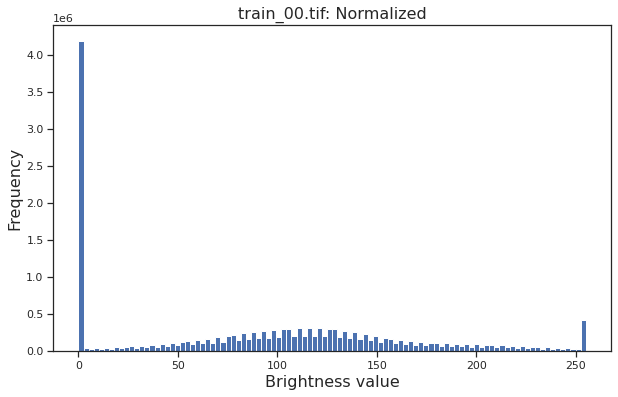

In [ ]:
# trainデータのファイルパス、ファイル名、アノテーションデータを取得(train_00.tif)
train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=0)

# train_00.tifとアノテーションデータを読み込み
data = tifffile.imread(train_tif_path)
with open(anno_path, "r") as fp:
    annotation = json.load(fp)

# 対数をとる
data_log = np.log1p(data)

# 欠損値
data_log_nan = np.where(data_log == 0, np.nan, data_log)
# 欠損していないデータ
data_log_non_nan = data_log_nan[~np.isnan(data_log_nan)]

# パーセンタイル 3%, 97%で正規化　目視しやすいように。
# c_arrayには3%、97%点が、リストで格納される。
c_array = np.percentile(data_log_non_nan, q=[3, 97])

# 正規化(データを0~255に変換する)
# データから正規化する最小値を引き、正規化するレンジで割る（最小が0, 最大が１になる） -> 255をかけると、0~255になる
data_log_normalized = (data_log - c_array[0]) / (c_array[1] - c_array[0]) * 255
# 0以下、255以上をnp.clipでクリップする。
data_log_normalized = np.clip(data_log_normalized, 0, 255)
# dtypeをnp.uint8に変換
data_log_normalized = data_log_normalized.astype(np.uint8)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))
ax.hist(data_log_normalized.flatten(), bins=100)
ax.set_title(f'{train_tif_name}: Normalized', fontsize=16)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)

plt.show()

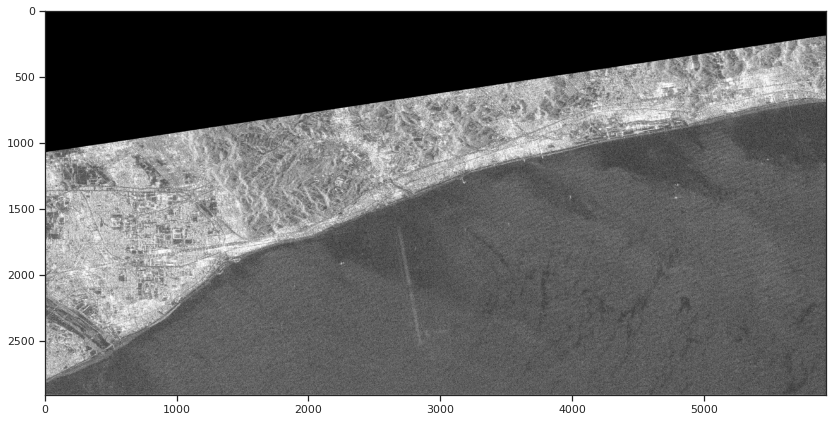

In [ ]:
# 正規化したデータをグレースケールで表示
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 8))
ax.imshow(data_log_normalized, cmap="gray")

アノテーションを赤で色付けしてみる。

In [ ]:
# 正規化したデータと同じshapeの零行列を用意
data_anno = np.zeros_like(data_log_normalized)
print(f'data_anno shape:\n{data_anno.shape}')
print(True if data_anno.shape == data_log_normalized.shape else False)

data_anno shape:
(2914, 5925)
True


In [ ]:
# coastling_pointsをデータフレームに格納
df = pd.DataFrame(annotation['coastline_points'], columns=["x", "y"])
df.head()

,x,y
0,5878,698
1,5880,698
2,5881,698
3,5882,698
4,5883,698


In [ ]:
# df.iterrows()で1行ずつ座標を取り出し、その座標部分を1、それ以外は0に設定
for _, row in df.iterrows():
    x = row['x']
    y = row['y']
    data_anno[y, x] = 1

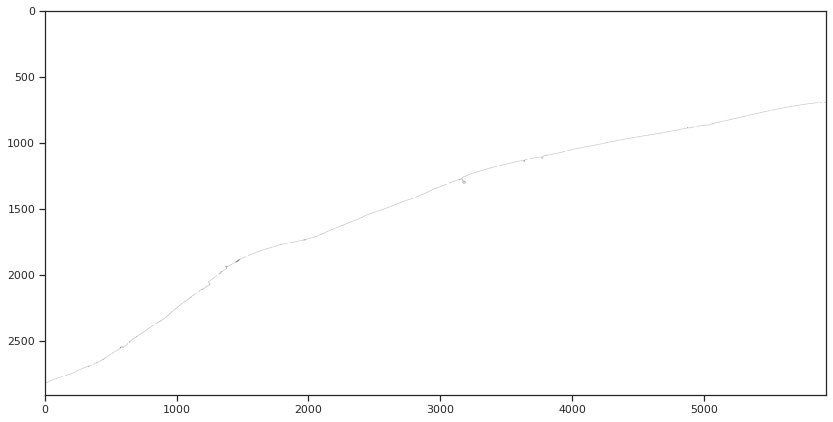

In [ ]:
# アノテーションを表示
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 8))
ax.imshow(data_anno, cmap="gray_r")

(2914, 5925, 3)


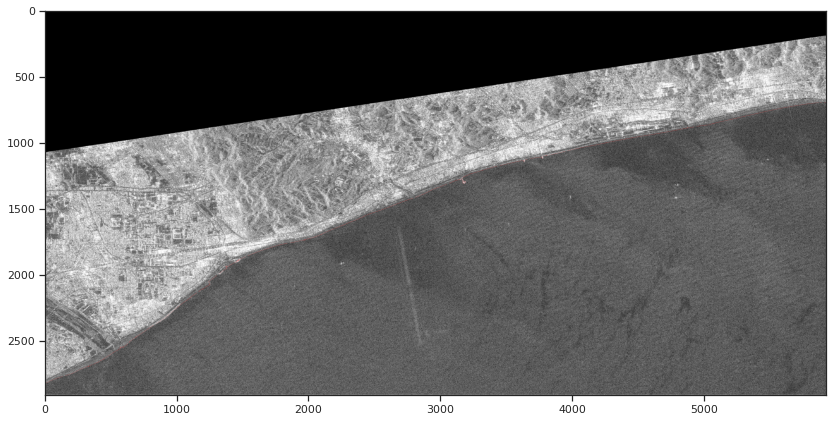

In [ ]:
# RGB作成(axis=2方向に3チャンネル分stackする)
img_rgb = np.stack([data_log_normalized, data_log_normalized, data_log_normalized], axis=2)
print(img_rgb.shape)

# アノテーション点の箇所をRed色にする
img_rgb[:, :, 0] = np.where(data_anno == 1, 255, img_rgb[:, :, 0])

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 8))
ax.imshow(img_rgb)

In [ ]:
# OpenCVで保存（OpenCVはBGR）
img_rgb = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2RGB)
cv2.imwrite('test_gray.jpg', img_rgb)

True

train画像とアノテーションを重ね合わせることができた。

#### 2.9.1.1 アノテーション用画像保存
- 全trainデータとアノテーションを重ね合わせて保存する。

In [ ]:
# アノテーション用画像を保存
for idx in range(len(TRAIN_IMAGES_PATH)):
    save_annotation_image(idx=idx)

Saved: ../data/annotation_image/image_anno_00.png
Saved: ../data/annotation_image/image_anno_01.png
Saved: ../data/annotation_image/image_anno_02.png
Saved: ../data/annotation_image/image_anno_03.png
Saved: ../data/annotation_image/image_anno_04.png
Saved: ../data/annotation_image/image_anno_05.png
Saved: ../data/annotation_image/image_anno_06.png
Saved: ../data/annotation_image/image_anno_07.png
Saved: ../data/annotation_image/image_anno_08.png
Saved: ../data/annotation_image/image_anno_09.png
Saved: ../data/annotation_image/image_anno_10.png
Saved: ../data/annotation_image/image_anno_11.png
Saved: ../data/annotation_image/image_anno_12.png
Saved: ../data/annotation_image/image_anno_13.png
Saved: ../data/annotation_image/image_anno_14.png
Saved: ../data/annotation_image/image_anno_15.png
Saved: ../data/annotation_image/image_anno_16.png
Saved: ../data/annotation_image/image_anno_17.png
Saved: ../data/annotation_image/image_anno_18.png
Saved: ../data/annotation_image/image_anno_19.png


### 2.9.2 標準化検討

画像毎に輝度値の平均と分散が異なるため、輝度値の標準化（平均０、標準偏差1）を行いました。

train00

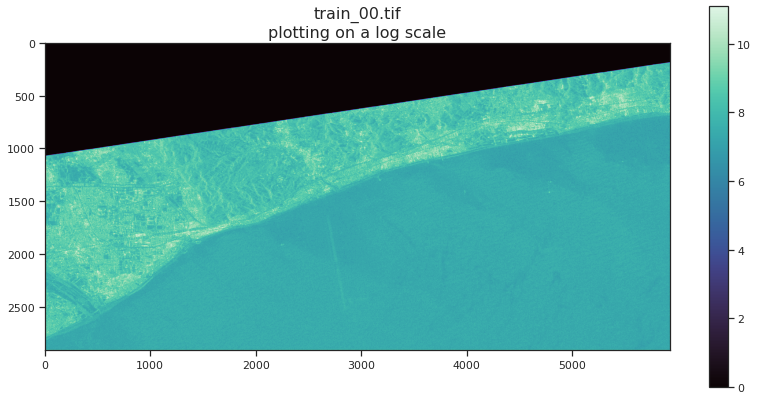

In [ ]:
# データの読み込み
train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=0)

data = tifffile.imread(train_tif_path)

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(14, 7))

# logスケールで可視化
axes.set_title(f"{train_tif_name}\nplotting on a log scale", fontsize=16)
data_log = np.log1p(data)
image_log = axes.imshow(data_log, cmap='mako')
fig.colorbar(image_log, ax=axes)

plt.show()

data_log shape: (2914, 5925)


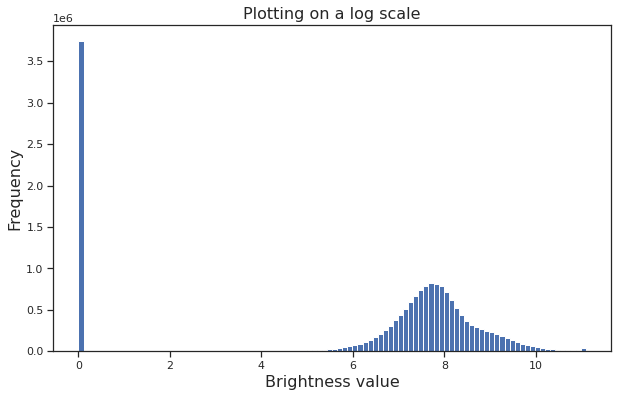

In [ ]:
# 輝度のヒストグラム（log scale）
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))
print(f'data_log shape: {data_log.shape}')

ax.hist(data_log.flatten(), bins=100)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Plotting on a log scale', fontsize=16)

plt.show()

0の頻度が大きいので、０は欠損値として処理する

data_log_zero_is_nan shape: (2914, 5925)


/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


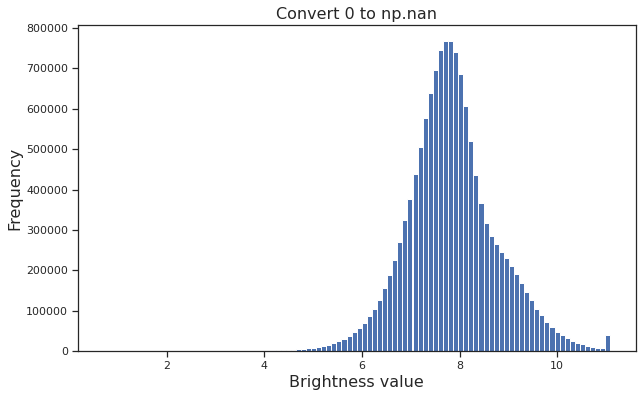

In [ ]:
# 0の部分は欠損値として処理
data_log_zero_is_nan = np.where(data_log == 0, np.nan, data_log)
print(f'data_log_zero_is_nan shape: {data_log_zero_is_nan.shape}')

# 輝度のヒストグラム
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))

ax.hist(data_log_zero_is_nan.flatten(), bins=100)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Convert 0 to np.nan', fontsize=16)

plt.show()

- 0のデータを除外することができた。
- 正規分布を示しているので、標準化正規分布に変換する。

data_log_normalized
shape: (2914, 5925)
mean: 1.797656929855935e-15
std: 1.0000000000000009


/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


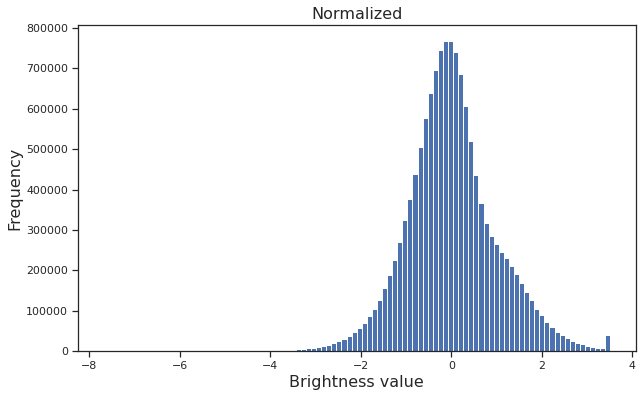

In [ ]:
# 標準化(平均=0, 標準偏差=1)

# 偏差(データ - 平均)を計算
normalized_numerator = (data_log_zero_is_nan
                        - np.mean(data_log_zero_is_nan[~np.isnan(data_log_zero_is_nan)]))

# 標準偏差を計算
normalized_denominator = np.std(data_log_zero_is_nan[~np.isnan(data_log_zero_is_nan)])

# 偏差/標準偏差で標準化
data_log_normalized = normalized_numerator / normalized_denominator

print('data_log_normalized')
print(f'shape: {data_log_normalized.shape}')
print(f'mean: {np.mean(data_log_normalized[~np.isnan(data_log_normalized)])}')
print(f'std: {np.std(data_log_normalized[~np.isnan(data_log_normalized)])}')

# 輝度のヒストグラムを表示
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))

ax.hist(data_log_normalized.flatten(), bins=100)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Normalized', fontsize=16)

plt.show()

輝度値の平均が０、標準偏差を１に標準化できていることが確認できる。

標準化前後でtrainデータを可視化して比較する。

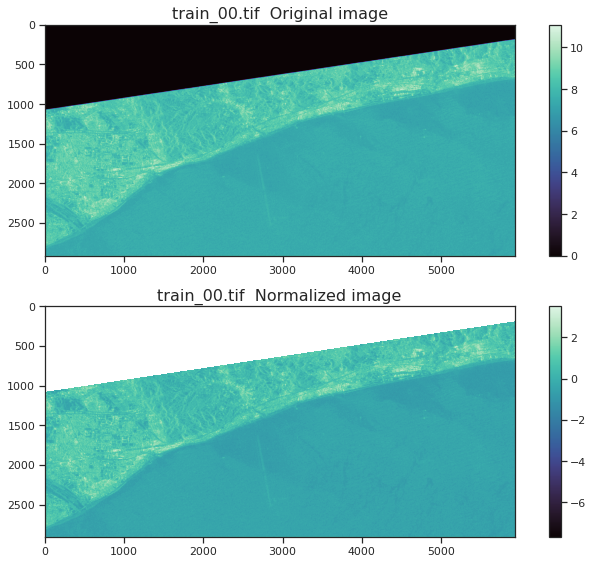

In [ ]:
# 標準化前後で可視化して比較する
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 8))

# 標準化前を可視化
axes[0].set_title(f"{train_tif_name}  Original image", fontsize=16)
image = axes[0].imshow(data_log, cmap='mako')
fig.colorbar(image, ax=axes[0])

# 標準化後を可視化
axes[1].set_title(f"{train_tif_name}  Normalized image", fontsize=16)
image_normalized = axes[1].imshow(data_log_normalized, cmap='mako')
fig.colorbar(image_normalized, ax=axes[1])

fig.tight_layout()

標準化した輝度値を、0~255のnp.uint8のグレースケールに変換する。

In [ ]:
# データの読み込み
train_tif_path, train_tif_name, anno_path = load_path_train_and_anno(idx=0)
data = tifffile.imread(train_tif_path)

# logスケールで可視化
data_log = np.log1p(data)

# 0の部分は欠損値として処理
data_log_zero_is_nan = np.where(data_log == 0, np.nan, data_log)

# 偏差(データ - 平均)を計算
normalized_numerator = (data_log_zero_is_nan
                        - np.mean(data_log_zero_is_nan[~np.isnan(data_log_zero_is_nan)]))

# 標準偏差を計算
normalized_denominator = np.std(data_log_zero_is_nan[~np.isnan(data_log_zero_is_nan)])

# 偏差/標準偏差で標準化(平均=0, 標準偏差=1)
data_log_normalized = normalized_numerator / normalized_denominator

# ±3σでclip
data_log_normalized = np.clip(data_log_normalized, -3, 3)
# [0 - 255]
data_log_normalized = (data_log_normalized + 3) * (255/6)
# 1未満は1に置き換え
data_log_normalized = np.where(data_log_normalized < 1, 1, data_log_normalized)
# nanだった箇所を0に置き換え
data_log_normalized = np.where(np.isnan(data_log_zero_is_nan), 0, data_log_normalized)
# np.uint8に変換
data_log_normalized = data_log_normalized.astype(np.uint8)

img = data_log_normalized

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in less


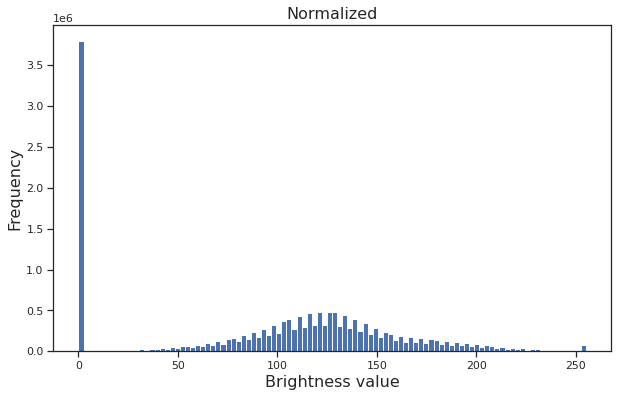

In [ ]:
# 輝度のヒストグラムを表示
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))

ax.hist(data_log_normalized.flatten(), bins=100)
ax.set_xlabel('Brightness value', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Normalized', fontsize=16)

plt.show()

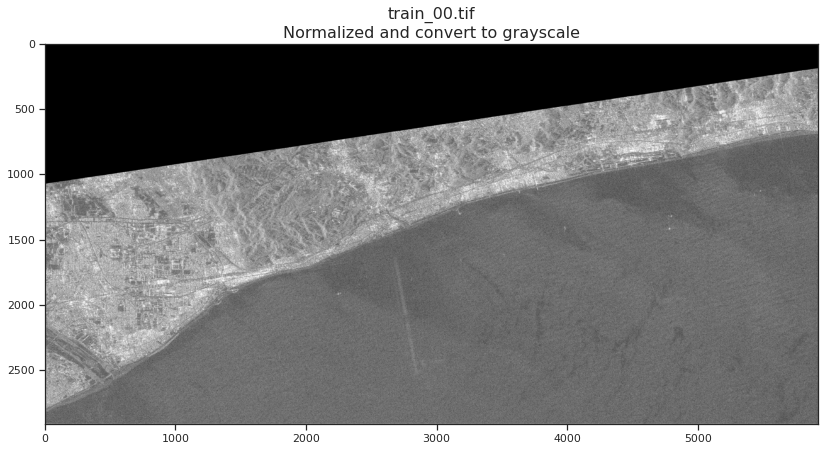

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 7))

ax.set_title(f"{train_tif_name}\nNormalized and convert to grayscale", fontsize=16)
ax.imshow(data_log_normalized, cmap='gray')

plt.show()

輝度値が0-255に標準化されたグレースケールに変換できていることが確認できた。
本項のコードは、normalized_and_convert_to_grayscale()として関数化した。

### 2.9.3 trainデータ（標準化＋グレースケール）画像保存

In [ ]:
for idx in range(len(TRAIN_IMAGES_PATH)):

    image, filename = normalized_and_convert_to_grayscale(idx=idx, phase='train')
    if not os.path.exists('train_image_rev/'):
        os.makedirs('train_image_rev/')
    savepath = f'train_image_rev/{filename}.png'
    cv2.imwrite(savepath, image)
    print("Saved: {}".format(savepath))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: invalid value encountered in less


Saved: train_image_rev/train_00.png
Saved: train_image_rev/train_01.png
Saved: train_image_rev/train_02.png
Saved: train_image_rev/train_03.png
Saved: train_image_rev/train_04.png
Saved: train_image_rev/train_05.png
Saved: train_image_rev/train_06.png
Saved: train_image_rev/train_07.png
Saved: train_image_rev/train_08.png
Saved: train_image_rev/train_09.png
Saved: train_image_rev/train_10.png
Saved: train_image_rev/train_11.png
Saved: train_image_rev/train_12.png
Saved: train_image_rev/train_13.png
Saved: train_image_rev/train_14.png
Saved: train_image_rev/train_15.png
Saved: train_image_rev/train_16.png
Saved: train_image_rev/train_17.png
Saved: train_image_rev/train_18.png
Saved: train_image_rev/train_19.png
Saved: train_image_rev/train_20.png
Saved: train_image_rev/train_21.png
Saved: train_image_rev/train_22.png
Saved: train_image_rev/train_23.png
Saved: train_image_rev/train_24.png


#### trainデータ（標準化+グレースケール）全体可視化

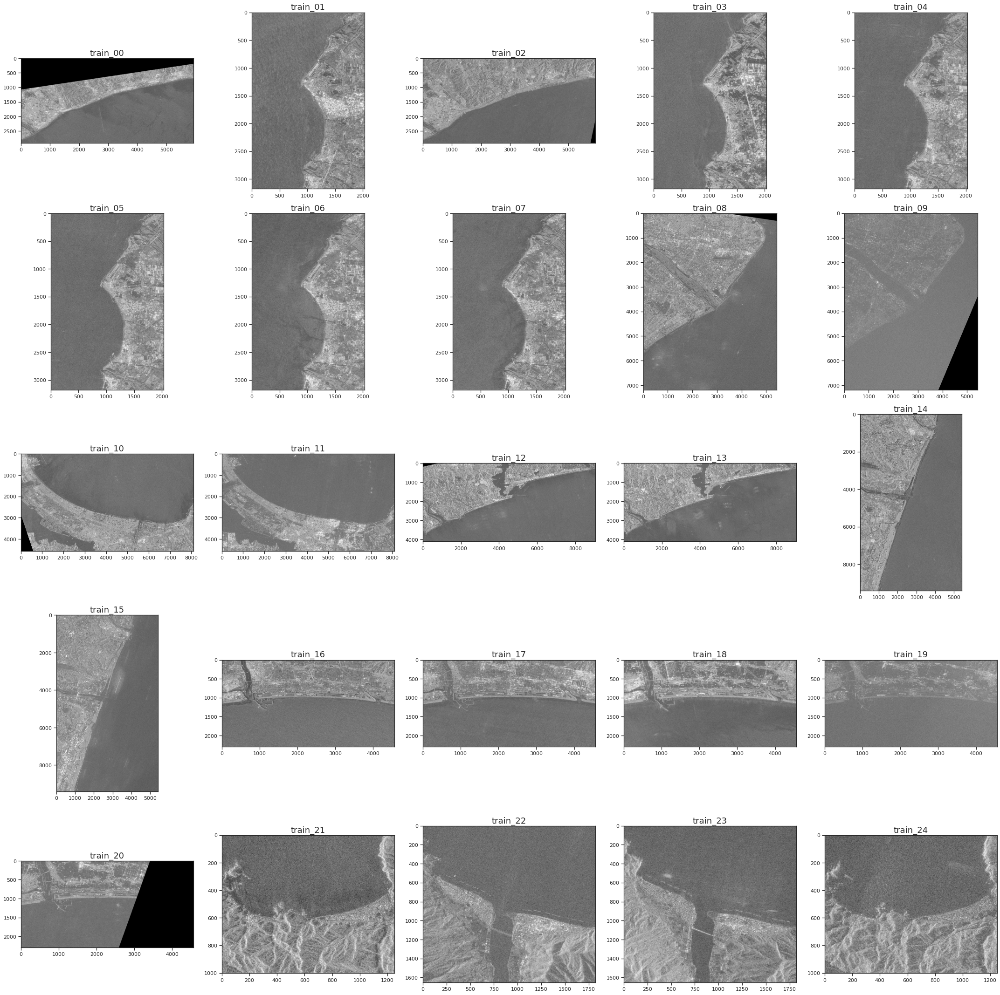

In [ ]:
# trainデータ（標準化＋グレースケール）のパス
train_image_path = glob.glob('train_image_rev/*') 
# 表示させる最大画像枚数(25)
max_count = len(train_image_path)
# 5列
ncols = 5
# 5行
nrows = max_count // ncols

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6*ncols, 6*nrows))
for idx in range(max_count):
    # train画像を可視化
    data = cv2.imread(train_image_path[idx])
    row, col = divmod(idx, ncols)
    ax[row][col].set_title(f"train_{idx:02d}", fontsize=18)
    ax[row][col].imshow(data)

fig.tight_layout()

train画像には同じシーンが複数含まれている。

### 2.9.4 testデータ（標準化+グレースケール）画像保存

In [ ]:
for idx in range(len(TEST_IMAGES_PATH)):

    image, filename = normalized_and_convert_to_grayscale(idx=idx, phase='test')
    if not os.path.exists('test_image_rev/'):
        os.makedirs('test_image_rev/')
    savepath = f'test_image_rev/{filename}.png'
    cv2.imwrite(savepath, image)
    print("Saved: {}".format(savepath))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: invalid value encountered in less


Saved: test_image_rev/test_00.png
Saved: test_image_rev/test_01.png
Saved: test_image_rev/test_02.png
Saved: test_image_rev/test_03.png
Saved: test_image_rev/test_04.png
Saved: test_image_rev/test_05.png
Saved: test_image_rev/test_06.png
Saved: test_image_rev/test_07.png
Saved: test_image_rev/test_08.png
Saved: test_image_rev/test_09.png
Saved: test_image_rev/test_10.png
Saved: test_image_rev/test_11.png
Saved: test_image_rev/test_12.png
Saved: test_image_rev/test_13.png
Saved: test_image_rev/test_14.png
Saved: test_image_rev/test_15.png
Saved: test_image_rev/test_16.png
Saved: test_image_rev/test_17.png
Saved: test_image_rev/test_18.png
Saved: test_image_rev/test_19.png
Saved: test_image_rev/test_20.png
Saved: test_image_rev/test_21.png
Saved: test_image_rev/test_22.png
Saved: test_image_rev/test_23.png
Saved: test_image_rev/test_24.png
Saved: test_image_rev/test_25.png
Saved: test_image_rev/test_26.png
Saved: test_image_rev/test_27.png
Saved: test_image_rev/test_28.png
Saved: test_im

#### testデータ（標準化+グレースケール）全体可視化


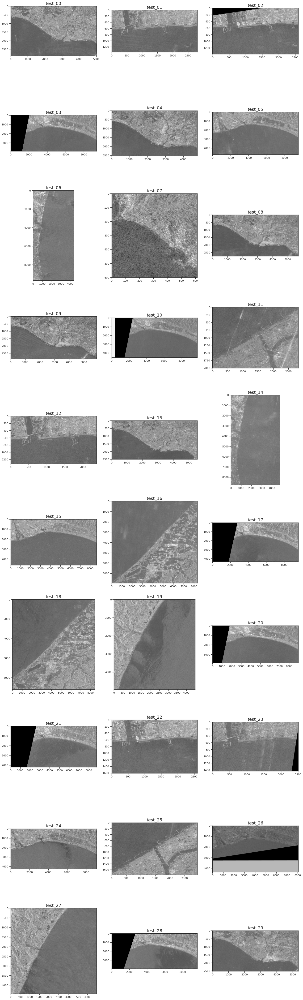

In [ ]:
# testデータ（グレースケール）のパス
test_image_path = sorted(glob.glob('test_image_rev/*'))

# 表示させる最大画像枚数(30)
max_count = len(test_image_path)
# 3列
ncols = 3
# 10行
nrows = max_count // ncols

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6*ncols, 6*nrows))
for idx in range(max_count):
    # test画像を可視化
    data = cv2.imread(test_image_path[idx])
    row, col = divmod(idx, ncols)
    ax[row][col].set_title(f"test_{idx:02d}", fontsize=18)
    ax[row][col].imshow(data)

fig.tight_layout()

### 2.9.5 セグメンテーションマスク画像のパレットモードへの変換
セマンティックセグメンテーション用に、マスクをRGBではなく、カラーパレット形式で保存する。

In [ ]:
# 手動で海と陸を塗り分けたマスク画像のパス
train_anno_list = sorted(glob.glob("label_image/*.png"))
print(train_anno_list)

['label_image/label_00.png', 'label_image/label_01.png', 'label_image/label_02.png', 'label_image/label_03.png', 'label_image/label_04.png', 'label_image/label_05.png', 'label_image/label_06.png', 'label_image/label_07.png', 'label_image/label_08.png', 'label_image/label_09.png', 'label_image/label_10.png', 'label_image/label_11.png', 'label_image/label_12.png', 'label_image/label_13.png', 'label_image/label_14.png', 'label_image/label_15.png', 'label_image/label_16.png', 'label_image/label_17.png', 'label_image/label_18.png', 'label_image/label_19.png', 'label_image/label_20.png', 'label_image/label_21.png', 'label_image/label_22.png', 'label_image/label_23.png', 'label_image/label_24.png']


In [ ]:
# パレットモードに変換して保存しなおし
for idx, img in enumerate(train_anno_list):
    img_mask = Image.open(img)
    img_mask = img_mask.convert('P')

    filename = os.path.split(img)[1]
    file_no = os.path.splitext(filename)[0].split("_")[-1]

    if not os.path.exists('mask_image_rev/'):
        os.makedirs('mask_image_rev/')
  
    filename = "mask_image_rev/mask_{:02d}.png".format(int(file_no))
    img_mask.save(filename)

In [ ]:
# モード確認
print(img_mask.mode)

P


#### マスク画像　全体可視化
train画像とそれに対応するマスク画像を並べて可視化する。

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


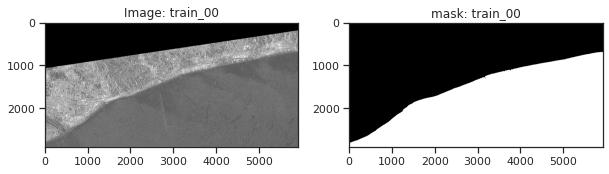

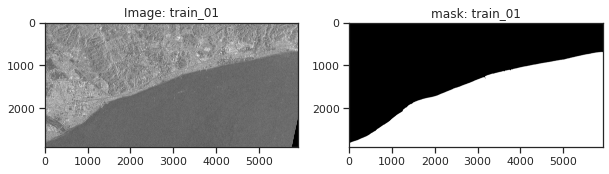

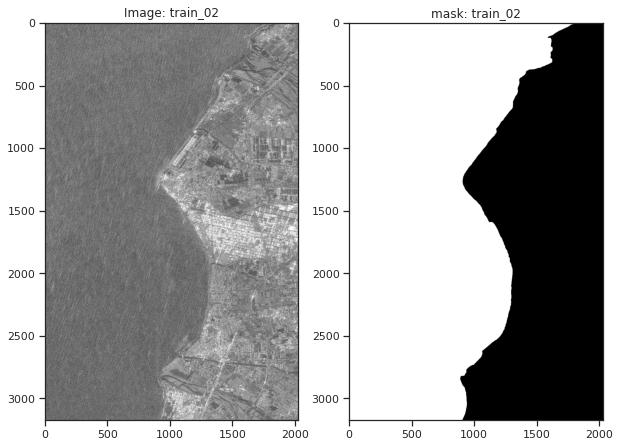

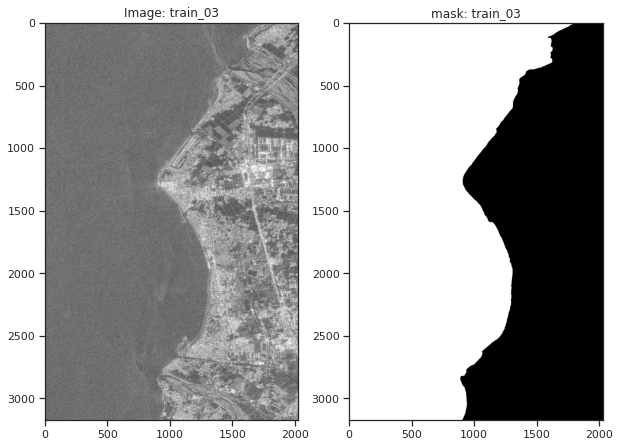

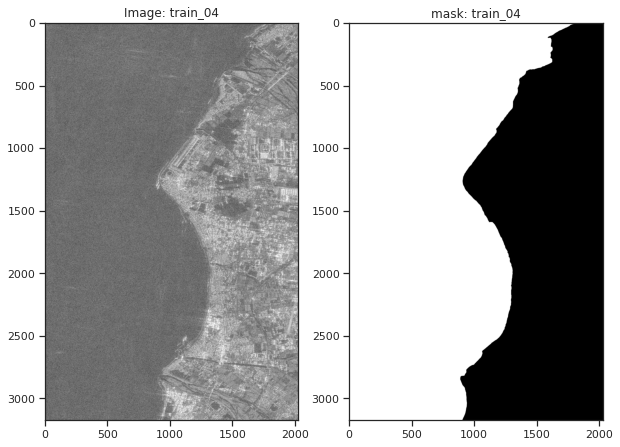

...

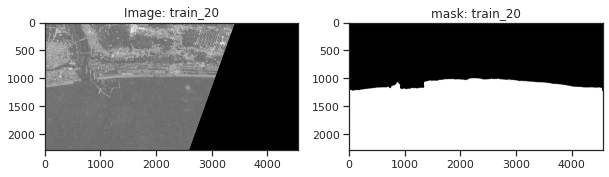

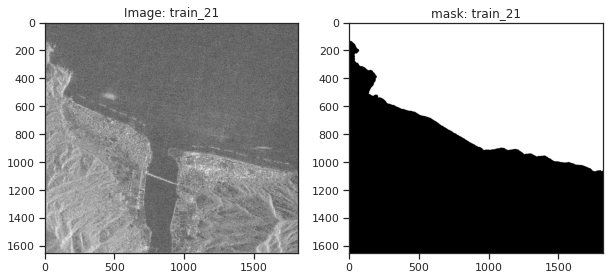

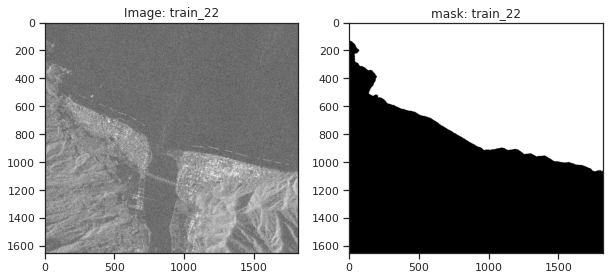

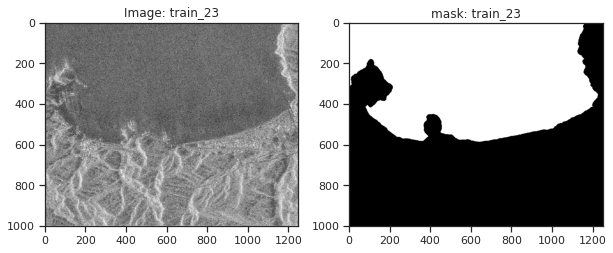

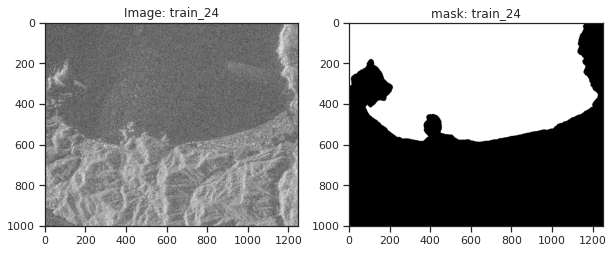

In [ ]:
# trainデータ（標準化＋グレースケール）のパス
train_images = sorted(glob.glob('train_image_rev/*'))
# 海と陸を手動で塗り分けたmask画像
mask_images = sorted(glob.glob('mask_image_rev/*'))

for train_path, mask_path in zip(train_images, mask_images):
    image = cv2.imread(train_path)
    mask = cv2.imread(mask_path)
    name = os.path.split(train_path)[-1]
    # 拡張子を除外し、ファイル名のみ取り出す
    name = name[:-4]
    show_mask(name=name, image=image, mask=mask)